In [448]:
import torch
import torch.nn as nn
import os 
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
import pandas as pd
import random
from sklearn.utils import shuffle
import requests
import zipfile
from pathlib import Path
from matplotlib.image import imread
import matplotlib.pyplot as plt
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
import pathlib

# Get data

In [258]:
device = "cpu"

In [7]:
data_path = Path("data/")
image_path = data_path/ "pizza_steak_sushi"


if image_path.is_dir():
    print(f"{image_path} directory already exists .... skipping download")
    
else:
    print(f"{image_path} does not exist, creating one...")
    image_path.mkdir(parents=True, exist_ok = True)
    
with open(data_path / "pizza_steak_sushi.zip", "wb") as f: 
    
    request = requests.get("https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi.zip")
    print("Downloading pizza_steak_sushi data")
     
    f.write(request.content)
    
with zipfile.ZipFile(data_path/ "pizza_steak_sushi.zip", "r") as zip_ref:
    print("Unzipping pizza, steak and sushi")
    zip_ref.extractall(image_path)

data/pizza_steak_sushi directory already exists .... skipping download
Unzipping pizza, steak and sushi


In [87]:
image_path

PosixPath('data/pizza_steak_sushi')

# Data exploration

In [90]:
def walk_through_dir(dir_path):
    for dirpath, dirnames, filenames in os.walk(dir_path):
        print(f" There are {len(dirnames)} directories and {len(filenames)} images in  {dirpath}.")

In [91]:
walk_through_dir(image_path)

 There are 2 directories and 0 images in  data/pizza_steak_sushi.
 There are 3 directories and 0 images in  data/pizza_steak_sushi/test.
 There are 0 directories and 19 images in  data/pizza_steak_sushi/test/steak.
 There are 0 directories and 31 images in  data/pizza_steak_sushi/test/sushi.
 There are 0 directories and 25 images in  data/pizza_steak_sushi/test/pizza.
 There are 3 directories and 0 images in  data/pizza_steak_sushi/train.
 There are 0 directories and 75 images in  data/pizza_steak_sushi/train/steak.
 There are 0 directories and 72 images in  data/pizza_steak_sushi/train/sushi.
 There are 0 directories and 78 images in  data/pizza_steak_sushi/train/pizza.


In [12]:
train_dir = image_path/ "train"
print(train_dir)
test_dir = image_path/ "test"
test_dir

data/pizza_steak_sushi/train


PosixPath('data/pizza_steak_sushi/test')

In [13]:
# getting all path
image_path_list =  list(image_path.glob("*/*/*.jpg"))


shape : (512, 512, 3)


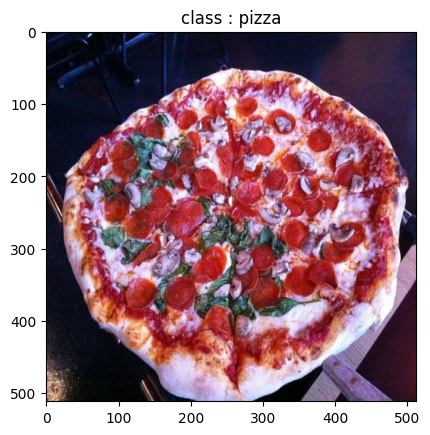

In [185]:
random_path = random.choice(image_path_list)

random_image = imread(random_path)

plt.imshow(random_image)
plt.title(f"class : {random_path.parent.stem}")
print(f"shape : {random_image.shape}")


### Transform the data to Tensor and data augmentation

In [362]:

# Train dataset transform
train_transform = transforms.Compose([
    transforms.Resize(size=(224, 224)),
    #transforms.TrivialAugmentWide(num_magnitude_bins=1),
    transforms.RandomRotation(degrees=(-180, 180)),
    transforms.RandomApply([transforms.ColorJitter(brightness=(0.8, 1.5))], p=0.5),  # Applique aléatoirement une légère luminosité
    transforms.ToTensor(),
    transforms.Normalize(
        [0.485, 0.456, 0.406],
        [0.229, 0.224, 0.225]
    )
])

# Test dataset transform
test_transform = transforms.Compose([
    transforms.Resize(size=(224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(
        [0.485, 0.456, 0.406],
        [0.229, 0.224, 0.225]
    )
])




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].


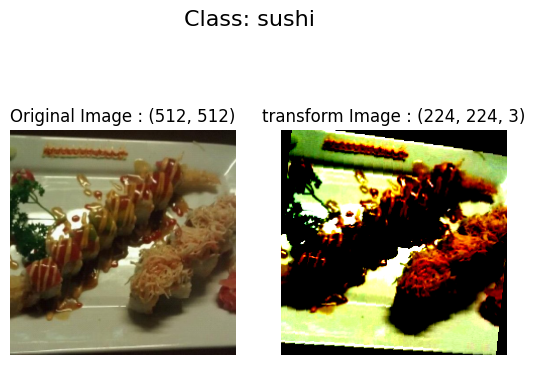

In [368]:
def plot_original_augment(image_path):
    """ Plot original and taugmented image """
    image_original = Image.open(image_path)
    augment_image = train_transform(image_original)
    
    augment_image = augment_image.permute(1,2,0)
    augment_image = augment_image.numpy()
    
    fig, ax = plt.subplots(1, 2)
    ax[0].imshow(image_original)
    ax[0].set_title(f"Original Image : {image_original.size}")
    ax[0].axis(False)
    
    ax[1].imshow(augment_image)
    ax[1].set_title(f"transform Image : {augment_image.shape}")
    ax[1].axis("off")

    fig.suptitle(f"Class: {image_path.parent.stem}", fontsize = 16)
    
random_path = random.choice(image_path_list)

plot_original_augment(random_path)

### Creating Custom Dataset

In [374]:
def find_classes(directory):
    """find the class folder names in a target directory"""
    
    classes = sorted(entry.name for entry in os.scandir(directory) if entry.is_dir())
    
    if not classes:
        raise FileNotFoundError(f"couldn't find any class in directory{directory}... please check file structure.")
        
        
    class_to_idx = {class_name: i for i,class_name in enumerate(classes) }
    
    return classes, class_to_idx

In [375]:
find_classes(target_directory)

(['pizza', 'steak', 'sushi'], {'pizza': 0, 'steak': 1, 'sushi': 2})

In [376]:

class Custom_image_dataset(Dataset):
    def __init__(self, targ_dir: str, transform= None):
        self.paths = list(pathlib.Path(targ_dir).glob("*/*.jpg"))
        
        self.transform = transform
        
        self.classes, self.class_to_idx = find_classes(targ_dir)
        
    def load_image(self, index: int):
        
        image_path = self.paths[index]
        
        return Image.open(image_path)
    
    def __len__(self):
        
        return len(self.paths)
    
    def __getitem__(self, index: int):
        
        "Return one sample of data, data and label (X,y)"
        
        img = self.load_image(index)
        
        class_name = self.paths[index].parent.name
        
        class_idx = self.class_to_idx[class_name]
        
        if self.transform:
            return self.transform(img), class_idx
        
        else:
            return img, class_idx

In [377]:
train_data_custom = Custom_image_dataset(targ_dir= train_dir, transform = train_transform)

test_data_custom = Custom_image_dataset(targ_dir= test_dir, transform= test_transform)

In [378]:
train_data_custom, test_data_custom

(<__main__.Custom_image_dataset at 0x36b4c2bd0>,
 <__main__.Custom_image_dataset at 0x36b368410>)

In [449]:
print(f"length Train data: {len(train_data_custom)}")
print(f"length Test data: {len(test_data_custom)}")

length Train data: 225
length Test data: 75


In [444]:
class_idx   = train_data_custom.class_to_idx
class_names =   train_data_custom.classes
class_idx, class_names

({'pizza': 0, 'steak': 1, 'sushi': 2}, ['pizza', 'steak', 'sushi'])

In [380]:
img, labels = train_data_custom[0][0], train_data_custom[0][1]


In [382]:
img_custom, label_custom = next(iter(train_dataloader))
img_custom.shape, label_custom.shape

(torch.Size([4, 3, 224, 224]), torch.Size([4]))

### Creating Dataloader

In [381]:
batch_size = 4
train_dataloader = DataLoader(train_data_custom, batch_size=batch_size, shuffle=True)
print(len(train_dataloader))


test_dataloader = DataLoader(test_data_custom, batch_size = batch_size, shuffle= False)
print(len(test_dataloader))

57
19


### Importing Accuracy function

In [272]:
import requests
from pathlib import Path

# Download helper functions from Learn PyTorch repo 
if Path("helper_functions.py").is_file():
    print("helper_functions.py already exists, skipping download")
else:
    print("Downloading helper_functions.py")
  # Note: you need the "raw" GitHub URL for this to work
    request = requests.get("https://raw.githubusercontent.com/mrdbourke/pytorch-deep-learning/main/helper_functions.py")
    with open("helper_functions.py", "wb") as f:
        f.write(request.content)

In [273]:
from helper_functions import accuracy_fn 

# Import pre- trained model from torchvision

In [ ]:
model = get_model("efficientnet_b0", weights="DEFAULT")
model

In [451]:
import torch.nn as nn
from torchvision.models import get_model
from torchinfo import summary

# Loading the model
model = get_model("efficientnet_b0", weights="DEFAULT")

# the value of the in_feature at output of feature par of the model
in_features = model.classifier[-1].in_features

# adding more layer to the classifier part
model.classifier = nn.Sequential(
    nn.Linear(in_features, 512),       
    nn.Linear(512, 3)              
)
model = model.to(device)

In [452]:
summary(model, input_size=(4, 3, 224, 224))  # Adaptez la taille d'entrée selon vos données

Layer (type:depth-idx)                                  Output Shape              Param #
EfficientNet                                            [4, 3]                    --
├─Sequential: 1-1                                       [4, 1280, 7, 7]           --
│    └─Conv2dNormActivation: 2-1                        [4, 32, 112, 112]         --
│    │    └─Conv2d: 3-1                                 [4, 32, 112, 112]         864
│    │    └─BatchNorm2d: 3-2                            [4, 32, 112, 112]         64
│    │    └─SiLU: 3-3                                   [4, 32, 112, 112]         --
│    └─Sequential: 2-2                                  [4, 16, 112, 112]         --
│    │    └─MBConv: 3-4                                 [4, 16, 112, 112]         1,448
│    └─Sequential: 2-3                                  [4, 24, 56, 56]           --
│    │    └─MBConv: 3-5                                 [4, 24, 56, 56]           6,004
│    │    └─MBConv: 3-6                              

# freezing the weights of the feature part of the model

In [433]:
#locking the param of the feature extractor of the pre entrain model.
for param in model.features.parameters():
    param.requires_grad = False
    

# Loss and Optimizer

In [434]:
# Define loss and optimizer
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# Training Loop

In [440]:

# Set the seed and start the timer
torch.manual_seed(42)

# hyperparameters
epochs = 1
history_train_loss = []
history_test_loss = []
batch_size = 4


for epoch in range(epochs):

    print(f"Epoch: {epoch}\n-------")

    ### Training
    train_loss = 0
    
    for batch, (X, y) in enumerate(train_dataloader):


        X, y = X.to(device), y.to(device)
        
        model.train()

        y_logits = model(X)

        loss = loss_fn(y_logits, y)

        train_loss += loss # accumulatively add up the loss per epoch

        optimizer.zero_grad()

        loss.backward()

        optimizer.step()

        # Print out how many samples have been seen
        if batch % 20 == 0:
            print(f"Looked at {int(batch * batch_size)}/{len(train_data_custom)} samples")

    model_name =  str(epoch) + "_" + "model.pth" 
    torch.save(model.state_dict(), model_name)
    print(f"Saving model: {model_name}")



    # Divide total train loss by length of train dataloader (average loss per batch per epoch)
    train_loss /= len(train_dataloader)
    history_train_loss.append(train_loss)

    ### Testing
    test_loss, test_acc = 0, 0

    model.eval()
    with torch.inference_mode():
        for batch, (X, y) in enumerate(test_dataloader):


            X, y = X.to(device), y.to(device)
            

            # 1. Forward pass
            test_logits = model(X)

            loss = loss_fn(test_logits, y)
            
            test_pred = torch.softmax(test_logits, dim=1).argmax(dim=1).to(device)
            
            test_acc += accuracy_fn(y_true=y, y_pred=test_pred)

            # 2. Calculate loss (accumatively)
            test_loss += loss # accumulatively add up the loss per epoch


        # Calculations on test metrics need to happen inside torch.inference_mode()
        test_loss /= len(test_dataloader)
        
        test_acc /= len(test_dataloader)
        
        history_test_loss.append(test_loss)

    ## Print out what's happening
    print(f"\nTrain loss: {train_loss:.5f} | Test loss: {test_loss:.5f}, Test acc: {test_acc:.2f}%\n")


Epoch: 0
-------
Looked at 0/225 samples
Looked at 80/225 samples
Looked at 160/225 samples
Saving model: 0_model.pth

Train loss: 0.49717 | Test loss: 0.38838, Test acc: 87.72%



### Loading the best model found

In [437]:
model.load_state_dict(torch.load("2_model.pth"))

/var/folders/v4/g3pbnw695ssbs756h6208bp40000gn/T/ipykernel_49401/3585041034.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("2_model.pth

<All keys matched successfully>

### Making prediction with the trained model

In [421]:
# 1. Take in a trained model, class names, image path, image size, a transform and target device
def pred_and_plot_image(model,
                        image_path, 
                        class_names,
                        image_size = (224, 224),
                        transform = None,
                        device = device):
    
    
    img = Image.open(image_path)

    # Create transformation for image (if one doesn't exist)
    if transform is not None:
        image_transform = transform
    else:
        image_transform = transforms.Compose([
            transforms.Resize(image_size),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225]),
        ])

    ### Predict on image ### 

    model.to(device)

    model.eval()
    
    with torch.inference_mode():
        transformed_image = image_transform(img).unsqueeze(dim=0)

        target_image_pred = model(transformed_image.to(device))

    #  Convert logits -> prediction probabilities 
    target_image_pred_probs = torch.softmax(target_image_pred, dim=1)

    #  Convert prediction probabilities -> prediction labels
    target_image_pred_label = torch.argmax(target_image_pred_probs, dim=1)

    #  Plot image with predicted label and probability 
    plt.figure()
    plt.imshow(img)
    plt.title(f"Pred: {class_names[target_image_pred_label]} | Prob: {target_image_pred_probs.max():.3f} | class : {image_path.parent.stem}")
    plt.axis(False);

#### Prediction on all testing dataset

/var/folders/v4/g3pbnw695ssbs756h6208bp40000gn/T/ipykernel_49401/91589767.py:49: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


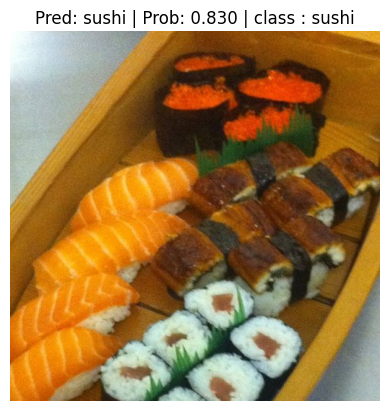

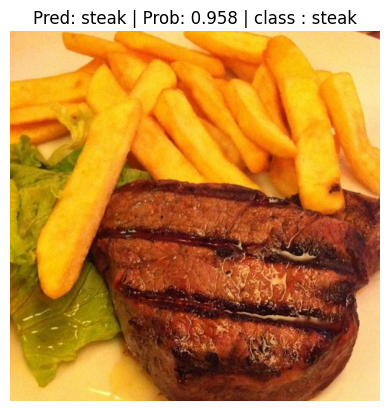

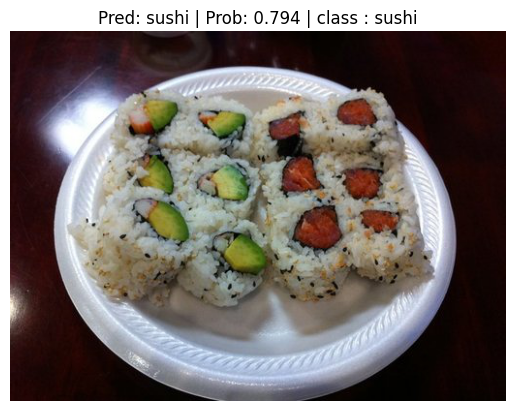

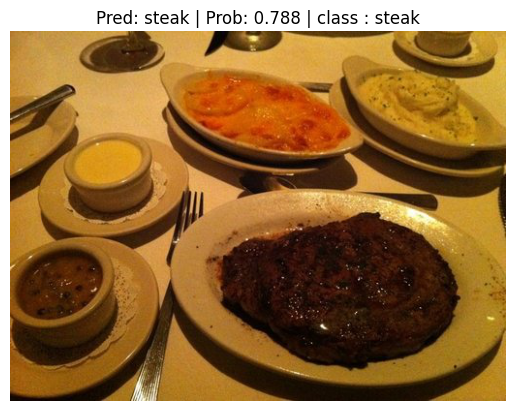

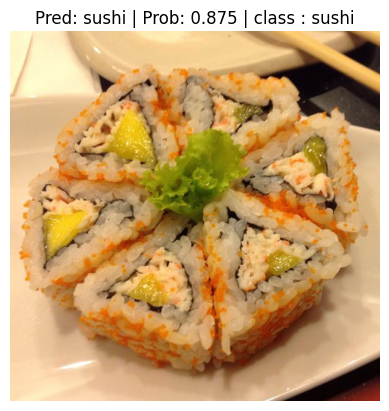

...

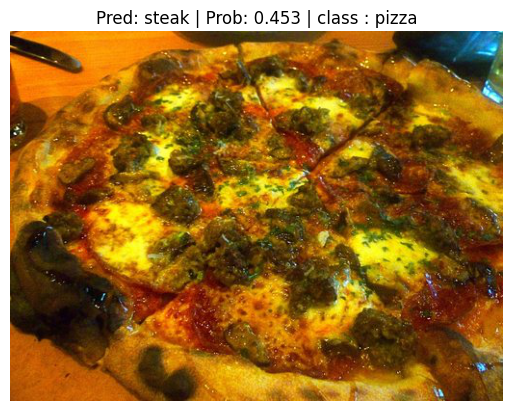

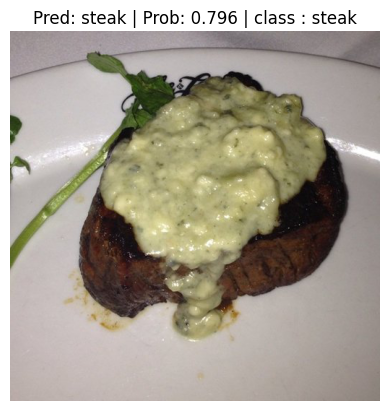

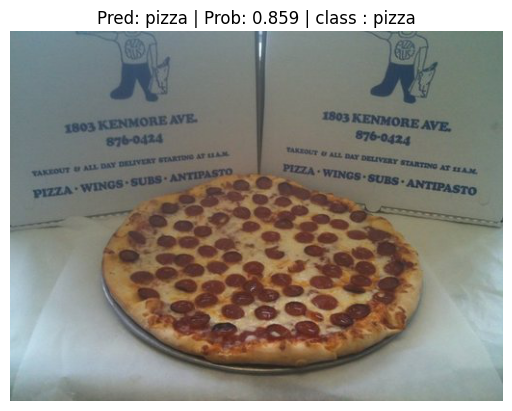

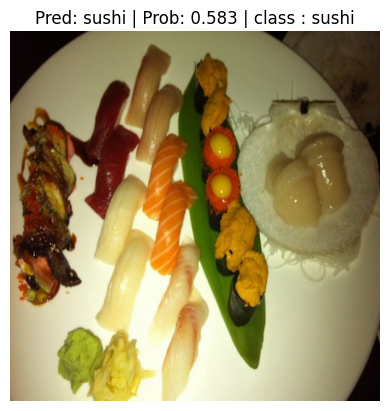

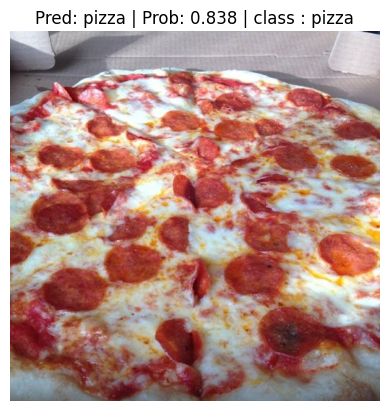

In [439]:
# Get a random list of image paths from test set
import random
num_images_to_plot = len(test_data_custom)
test_image_path_list = list(Path(test_dir).glob("*/*.jpg")) # get list all image paths from test data 
test_image_path_sample = random.sample(population=test_image_path_list, # go through all of the test image paths
                                       k=num_images_to_plot) # randomly select 'k' image paths to pred and plot

# Make predictions on and plot the images
for image_path in test_image_path_sample:
    pred_and_plot_image(model=model, 
                        image_path=image_path,
                        class_names=class_names,
                        # transform=weights.transforms(), # optionally pass in a specified transform from our pretrained model weights
                        image_size=(224, 224))